In [2]:
#export
#from exp.nb_12a import *
import math, random
import torch
from IPython.display import Audio
import torchaudio
from torchaudio import transforms
import pandas as pd
from pathlib import Path
from torch.utils.data import DataLoader, Dataset, random_split
import torch.nn.functional as F
from torch.nn import init
import matplotlib.pyplot as plt
import mimetypes
import os
from pathlib import Path
import re
import glob
import pandas as pd
import pylangacq as pla
import openpyxl
import numpy as np
import csv
from torch import nn

In [3]:
AUDIO_EXTS = {str.lower(k) for k,v in mimetypes.types_map.items() if v.startswith('audio/')}

In [4]:
AUDIO_EXTS

{'.3g2',
 '.3gp',
 '.3gpp',
 '.3gpp2',
 '.726',
 '.aa3',
 '.aac',
 '.aal',
 '.ac3',
 '.acn',
 '.adts',
 '.aif',
 '.aifc',
 '.aiff',
 '.amr',
 '.ass',
 '.at3',
 '.atx',
 '.au',
 '.awb',
 '.axa',
 '.csd',
 '.dls',
 '.dts',
 '.dtshd',
 '.ecelp4800',
 '.ecelp7470',
 '.ecelp9600',
 '.enw',
 '.eol',
 '.evb',
 '.evc',
 '.evw',
 '.flac',
 '.koz',
 '.l16',
 '.lbc',
 '.loas',
 '.lvp',
 '.m3u',
 '.m4a',
 '.mhas',
 '.mid',
 '.mlp',
 '.mp1',
 '.mp2',
 '.mp3',
 '.mpega',
 '.mpga',
 '.multitrack',
 '.mxmf',
 '.oga',
 '.ogg',
 '.omg',
 '.opus',
 '.orc',
 '.plj',
 '.pls',
 '.psid',
 '.pya',
 '.qcp',
 '.ra',
 '.ram',
 '.rip',
 '.rm',
 '.s1m',
 '.sco',
 '.sd2',
 '.sid',
 '.smp',
 '.smp3',
 '.smv',
 '.snd',
 '.sofa',
 '.spx',
 '.uva',
 '.uvva',
 '.vbk',
 '.wav',
 '.wax',
 '.wma',
 '.xhe'}

In [5]:
# Originals (interviewer + participant together)
orig_cookie_path = Path('/home/sjhjrok/MEGA/School/AI/Project/alzheimer/data/Pitt/cookie')
orig_control_path = orig_cookie_path/'Control'
orig_dementia_path = orig_cookie_path/'Dementia'

# Participants only, full descriptions
desc_cookie_path = Path('/home/sjhjrok/MEGA/School/AI/Project/alzheimer/data/Pitt/cookie-par/descriptions')
desc_control_path = desc_cookie_path/'Control'
desc_dementia_path = desc_cookie_path/'Dementia'

# Participants only, single utterances
utter_cookie_path = Path('/home/sjhjrok/MEGA/School/AI/Project/alzheimer/data/Pitt/cookie-par/utterances')
utter_control_path = utter_cookie_path/'Control'
utter_dementia_path = utter_cookie_path/'Dementia'

# Participants only, full descriptions, downsampled
ds_desc_cookie_path = Path('/home/sjhjrok/MEGA/School/AI/Project/alzheimer/data/Pitt/cookie-par-downsampled/descriptions')
ds_desc_control_path = ds_desc_cookie_path/'Control'
ds_desc_dementia_path = ds_desc_cookie_path/'Dementia'

# Participants only, single utterances, downsampled
ds_utter_cookie_path = Path('/home/sjhjrok/MEGA/School/AI/Project/alzheimer/data/Pitt/cookie-par-downsampled/utterances')
ds_utter_control_path = ds_utter_cookie_path/'Control'
ds_utter_dementia_path = ds_utter_cookie_path/'Dementia'

In [151]:
#export
from IPython.display import Audio
def show_audio(ad):
    sig,sr=ad
    display(Audio(data=sig, rate=sr))

In [152]:
#export
def show_audio_in_out(orig, trans):
    """Helper to plot input and output signal in different colors"""
    osig,osr = orig
    tsig,tsr = trans
    print("↓ Original ↓")
    show_audio(orig)
    print("↓ Transformed ↓")
    show_audio(trans)
    if orig is not None: plt.plot(osig[0], 'm', label="Orig.")
    if trans is not None: plt.plot(tsig[0], 'c', alpha=0.5, label="Transf.")
    plt.legend()
    plt.show()

In [153]:
test_file = '325-0.mp3'
print("\nOriginal\n", torchaudio.info(str(orig_dementia_path/test_file)))
print("\nExtracted\n", torchaudio.info(str(desc_dementia_path/test_file)))
print("\nDownsampled\n", torchaudio.info(str(ds_desc_dementia_path/test_file)))


Original
 AudioMetaData(sample_rate=44100, num_frames=2466432, num_channels=2, bits_per_sample=0, encoding=MP3)

Extracted
 AudioMetaData(sample_rate=44100, num_frames=1128960, num_channels=2, bits_per_sample=0, encoding=MP3)

Downsampled
 AudioMetaData(sample_rate=44100, num_frames=1128960, num_channels=2, bits_per_sample=0, encoding=MP3)


↓ Original ↓


↓ Transformed ↓


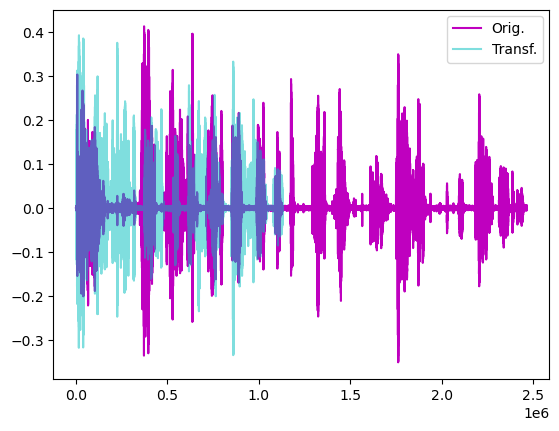

In [154]:
orig = torchaudio.load(str(orig_dementia_path/test_file))
desc = torchaudio.load(str(desc_dementia_path/test_file))

show_audio_in_out(orig, desc)

↓ Original ↓


↓ Transformed ↓


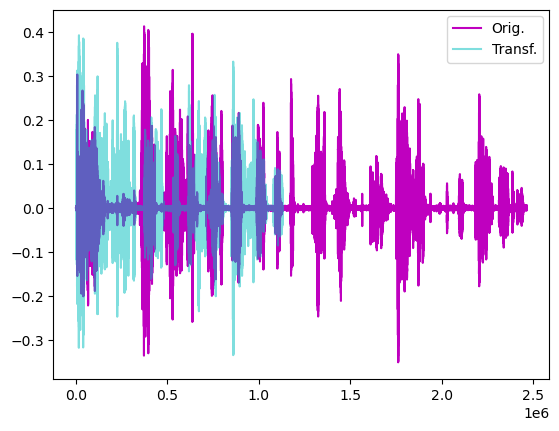

In [155]:
orig = torchaudio.load(str(orig_dementia_path/test_file))
ds_desc = torchaudio.load(str(ds_desc_dementia_path/test_file))

show_audio_in_out(orig, ds_desc)

In [156]:
ds_utter = torchaudio.load(str(ds_utter_dementia_path/'707-0-06.mp3'))
show_audio(ds_utter)

In [6]:
class AudioUtil():
  # ----------------------------
  # Load an audio file. Return the signal as a tensor and the sample rate
  # ----------------------------
  @staticmethod
  def open(audio_file):
    sig, sr = torchaudio.load(audio_file)
    return (sig, sr)
  # ----------------------------
  # Convert the given audio to the desired number of channels
  # ----------------------------
  @staticmethod
  def rechannel(aud, new_channel):
    sig, sr = aud

    if (sig.shape[0] == new_channel):
      # Nothing to do
      return aud

    if (new_channel == 1):
      # Convert from stereo to mono by selecting only the first channel
      resig = sig[:1, :]
    else:
      # Convert from mono to stereo by duplicating the first channel
      resig = torch.cat([sig, sig])

    return ((resig, sr))
  # ----------------------------
  # Since Resample applies to a single channel, we resample one channel at a time
  # ----------------------------
  @staticmethod
  def resample(aud, newsr):
    sig, sr = aud

    if (sr == newsr):
      # Nothing to do
      return aud

    num_channels = sig.shape[0]
    # Resample first channel
    resig = torchaudio.transforms.Resample(sr, newsr)(sig[:1,:])
    if (num_channels > 1):
      # Resample the second channel and merge both channels
      retwo = torchaudio.transforms.Resample(sr, newsr)(sig[1:,:])
      resig = torch.cat([resig, retwo])
    return ((resig, newsr))
  # ----------------------------
  # Pad (or truncate) the signal to a fixed length 'max_ms' in milliseconds
  # ----------------------------
  @staticmethod
  def pad_trunc(aud, max_ms):
    sig, sr = aud
    num_rows, sig_len = sig.shape
    max_len = sr//1000 * max_ms

    if (sig_len > max_len):
      # Truncate the signal to the given length
      sig = sig[:,:max_len]

    elif (sig_len < max_len):
      # Length of padding to add at the beginning and end of the signal
      pad_begin_len = random.randint(0, max_len - sig_len)
      pad_end_len = max_len - sig_len - pad_begin_len

      # Pad with 0s
      pad_begin = torch.zeros((num_rows, pad_begin_len))
      pad_end = torch.zeros((num_rows, pad_end_len))

      sig = torch.cat((pad_begin, sig, pad_end), 1)
      
    return (sig, sr)
  # ----------------------------
  # Shifts the signal to the left or right by some percent. Values at the end
  # are 'wrapped around' to the start of the transformed signal.
  # ----------------------------
  @staticmethod
  def time_shift(aud, shift_limit):
    sig,sr = aud
    _, sig_len = sig.shape
    shift_amt = int(random.random() * shift_limit * sig_len)
    return (sig.roll(shift_amt), sr)

  # ----------------------------
  # Generate a Spectrogram
  # ----------------------------
  @staticmethod
  def spectro_gram(aud, n_mels=64, n_fft=1024, hop_len=None):
    sig,sr = aud
    top_db = 80

    # spec has shape [channel, n_mels, time], where channel is mono, stereo etc
    spec = transforms.MelSpectrogram(sr, n_fft=n_fft, hop_length=hop_len, n_mels=n_mels)(sig)

    # Convert to decibels
    spec = transforms.AmplitudeToDB(top_db=top_db)(spec)
    return (spec)


  # ----------------------------
  # Augment the Spectrogram by masking out some sections of it in both the frequency
  # dimension (ie. horizontal bars) and the time dimension (vertical bars) to prevent
  # overfitting and to help the model generalise better. The masked sections are
  # replaced with the mean value.
  # ----------------------------
  @staticmethod
  def spectro_augment(spec, max_mask_pct=0.1, n_freq_masks=1, n_time_masks=1):
    _, n_mels, n_steps = spec.shape
    mask_value = spec.mean()
    aug_spec = spec

    freq_mask_param = max_mask_pct * n_mels
    for _ in range(n_freq_masks):
      aug_spec = transforms.FrequencyMasking(freq_mask_param)(aug_spec, mask_value)

    time_mask_param = max_mask_pct * n_steps
    for _ in range(n_time_masks):
      aug_spec = transforms.TimeMasking(time_mask_param)(aug_spec, mask_value)

    return aug_spec

In [8]:
aud = AudioUtil.open(str(ds_utter_dementia_path/'707-0-06.mp3'))
duration = 5000
sr = 44100
channel = 2
shift_pct = 0.4


# Some sounds have a higher sample rate, or fewer channels compared to the
# majority. So make all sounds have the same number of channels and same 
# sample rate. Unless the sample rate is the same, the pad_trunc will still
# result in arrays of different lengths, even though the sound duration is
# the same.
reaud = AudioUtil.resample(aud, sr)
rechan = AudioUtil.rechannel(reaud, channel)

dur_aud = AudioUtil.pad_trunc(rechan, duration)
shift_aud = AudioUtil.time_shift(dur_aud, shift_pct)
sgram = AudioUtil.spectro_gram(shift_aud, n_mels=64, n_fft=1024, hop_len=None)
aug_sgram = AudioUtil.spectro_augment(sgram, max_mask_pct=0.1, n_freq_masks=2, n_time_masks=2)

In [12]:
print(aug_sgram)
print(sgram)

tensor([[[-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         ...,
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621]],

        [[-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         ...,
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621],
         [-46.5621, -46.5621, -46.5621,  ..., -46.5621, -46.5621, -46.5621]]])
tensor([[[-46.5621, -46.5621, -46.5621,  ...

In [13]:
from pydub import AudioSegment
import matplotlib.pyplot as plt
from scipy.io import wavfile
from tempfile import mktemp

mp3_audio = AudioSegment.from_file(str(ds_utter_dementia_path/'707-0-06.mp3'), format="mp3")  # read mp3
wname = mktemp('.wav')  # use temporary file
mp3_audio.export(wname, format="wav")  # convert to wav
FS, data = wavfile.read(wname)  # read wav file
#plt.specgram(data, Fs=FS, NFFT=128, noverlap=0)  # plot
#plt.show()

Text(0, 0.5, 'Amplitude')

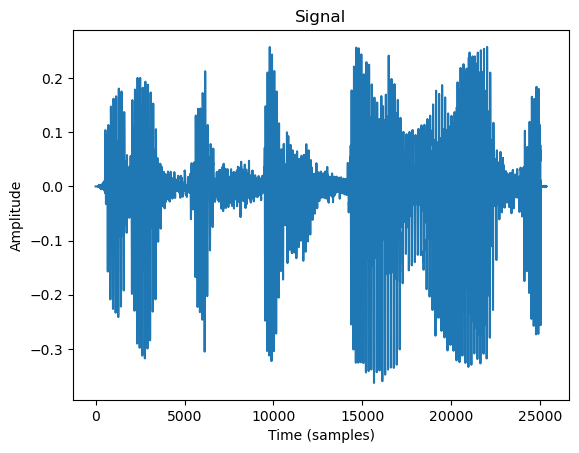

In [22]:
import librosa
import librosa.display
import matplotlib.pyplot as plty
y,sr = librosa.load(wname)
plt.plot(y)
plt.title('Signal')
plt.xlabel('Time (samples)')
plt.ylabel('Amplitude')


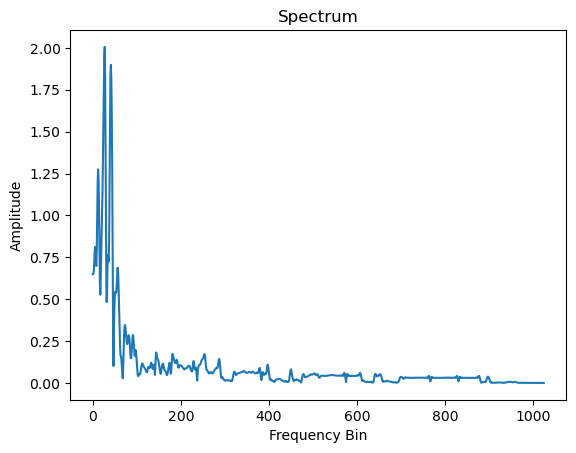

In [23]:

import numpy as np
n_fft = 2048
ft = np.abs(librosa.stft(y[:n_fft], hop_length = n_fft+1))
plt.plot(ft);
plt.title('Spectrum');
plt.xlabel('Frequency Bin');
plt.ylabel('Amplitude');

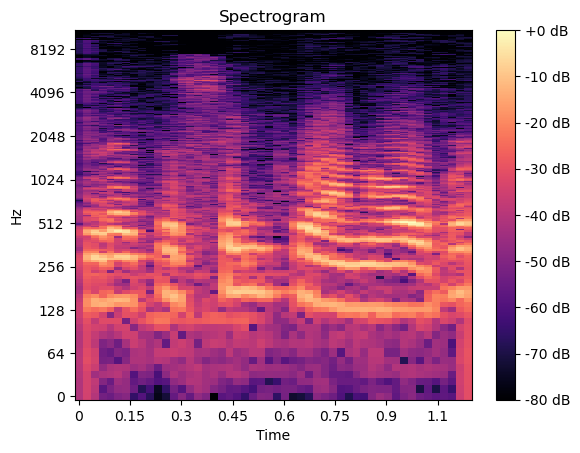

In [25]:
spec = np.abs(librosa.stft(y, hop_length=512))
spec = librosa.amplitude_to_db(spec, ref=np.max)
librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log');
plt.colorbar(format='%+2.0f dB');
plt.title('Spectrogram');

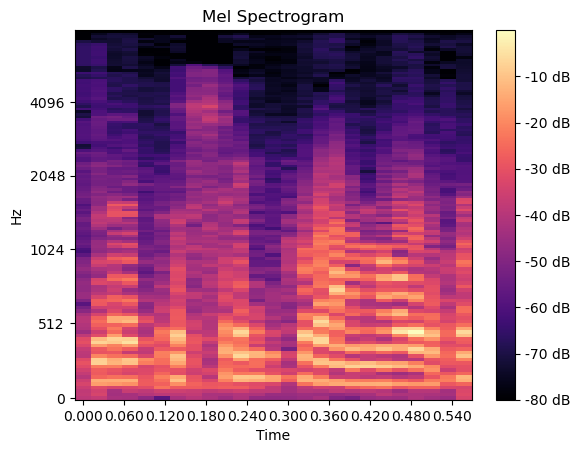

In [29]:
mel_spect = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=2048, hop_length=1024)
mel_spect = librosa.power_to_db(mel_spect, ref=np.max)
librosa.display.specshow(mel_spect, y_axis='mel', fmax=8000, x_axis='time');
plt.title('Mel Spectrogram');
plt.colorbar(format='%+2.0f dB');

In [158]:

# ----------------------------
# Sound Dataset
# ----------------------------
class SoundDS(Dataset):
  def __init__(self, df, data_path):
    self.df = df
    self.data_path = str(data_path)
    self.duration = 5000
    self.sr = 44100
    self.channel = 2
    self.shift_pct = 0.4
            
  # ----------------------------
  # Number of items in dataset
  # ----------------------------
  def __len__(self):
    return len(self.df)    
    
  # ----------------------------
  # Get i'th item in dataset
  # ----------------------------
  def __getitem__(self, idx):
    # Absolute file path of the audio file - concatenate the audio directory with
    # the relative path
    audio_file = self.data_path + self.df.loc[idx, 'relative_path']
    # Get the Class ID
    class_id = self.df.loc[idx, 'classID']

    aud = AudioUtil.open(audio_file)
    # Some sounds have a higher sample rate, or fewer channels compared to the
    # majority. So make all sounds have the same number of channels and same 
    # sample rate. Unless the sample rate is the same, the pad_trunc will still
    # result in arrays of different lengths, even though the sound duration is
    # the same.
    reaud = AudioUtil.resample(aud, self.sr)
    rechan = AudioUtil.rechannel(reaud, self.channel)

    dur_aud = AudioUtil.pad_trunc(rechan, self.duration)
    shift_aud = AudioUtil.time_shift(dur_aud, self.shift_pct)
    sgram = AudioUtil.spectro_gram(shift_aud, n_mels=64, n_fft=1024, hop_len=None)
    aug_sgram = AudioUtil.spectro_augment(sgram, max_mask_pct=0.1, n_freq_masks=2, n_time_masks=2)

    return aug_sgram, class_id

In [159]:
class AudioClassifier (torch.nn.Module):
    # ----------------------------
    # Build the model architecture
    # ----------------------------
    def __init__(self):
        super().__init__()
        conv_layers = []

        # First Convolution Block with Relu and Batch Norm. Use Kaiming Initialization
        self.conv1 = nn.Conv2d(2, 8, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
        self.relu1 = nn.ReLU()
        self.bn1 = nn.BatchNorm2d(8)
        init.kaiming_normal_(self.conv1.weight, a=0.1)
        self.conv1.bias.data.zero_()
        conv_layers += [self.conv1, self.relu1, self.bn1]

        # Second Convolution Block
        self.conv2 = nn.Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        self.relu2 = nn.ReLU()
        self.bn2 = nn.BatchNorm2d(16)
        init.kaiming_normal_(self.conv2.weight, a=0.1)
        self.conv2.bias.data.zero_()
        conv_layers += [self.conv2, self.relu2, self.bn2]

        # Second Convolution Block
        self.conv3 = nn.Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        self.relu3 = nn.ReLU()
        self.bn3 = nn.BatchNorm2d(32)
        init.kaiming_normal_(self.conv3.weight, a=0.1)
        self.conv3.bias.data.zero_()
        conv_layers += [self.conv3, self.relu3, self.bn3]

        # Second Convolution Block
        self.conv4 = nn.Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        self.relu4 = nn.ReLU()
        self.bn4 = nn.BatchNorm2d(64)
        init.kaiming_normal_(self.conv4.weight, a=0.1)
        self.conv4.bias.data.zero_()
        conv_layers += [self.conv4, self.relu4, self.bn4]

        # Linear Classifier
        self.ap = nn.AdaptiveAvgPool2d(output_size=1)
        self.lin = nn.Linear(in_features=64, out_features=10)

        # Wrap the Convolutional Blocks
        self.conv = nn.Sequential(*conv_layers)
 
    # ----------------------------
    # Forward pass computations
    # ----------------------------
    def forward(self, x):
        # Run the convolutional blocks
        x = self.conv(x)

        # Adaptive pool and flatten for input to linear layer
        x = self.ap(x)
        x = x.view(x.shape[0], -1)

        # Linear layer
        x = self.lin(x)

        # Final output
        return x

In [160]:
def training(model, train_dl, num_epochs):
  # Loss Function, Optimizer and Scheduler
  criterion = nn.CrossEntropyLoss()
  optimizer = torch.optim.Adam(model.parameters(),lr=0.0001)
  scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.001,
                                                steps_per_epoch=int(len(train_dl)),
                                                epochs=num_epochs,
                                                anneal_strategy='linear')

  # Repeat for each epoch
  for epoch in range(num_epochs):
    running_loss = 0.0
    correct_prediction = 0
    total_prediction = 0

    # Repeat for each batch in the training set
    for i, data in enumerate(train_dl):
        # Get the input features and target labels, and put them on the GPU
        inputs, labels = data[0].to(device), data[1].to(device)

        # Normalize the inputs
        inputs_m, inputs_s = inputs.mean(), inputs.std()
        inputs = (inputs - inputs_m) / inputs_s

        # Zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        scheduler.step()

        # Keep stats for Loss and Accuracy
        running_loss += loss.item()

        # Get the predicted class with the highest score
        _, prediction = torch.max(outputs,1)
        # Count of predictions that matched the target label
        correct_prediction += (prediction == labels).sum().item()
        total_prediction += prediction.shape[0]

        #if i % 10 == 0:    # print every 10 mini-batches
        #    print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss / 10))
    
    # Print stats at the end of the epoch
    num_batches = len(train_dl)
    avg_loss = running_loss / num_batches
    acc = correct_prediction/total_prediction
    print(f'Epoch: {epoch}, Loss: {avg_loss:.2f}, Accuracy: {acc:.2f}')

  print('Finished Training')

In [161]:
def inference (model, val_dl):
  correct_prediction = 0
  total_prediction = 0

  # Disable gradient updates
  with torch.no_grad():
    for data in val_dl:
      # Get the input features and target labels, and put them on the GPU
      inputs, labels = data[0].to(device), data[1].to(device)

      # Normalize the inputs
      inputs_m, inputs_s = inputs.mean(), inputs.std()
      inputs = (inputs - inputs_m) / inputs_s

      # Get predictions
      outputs = model(inputs)

      # Get the predicted class with the highest score
      _, prediction = torch.max(outputs,1)
      # Count of predictions that matched the target label
      correct_prediction += (prediction == labels).sum().item()
      total_prediction += prediction.shape[0]
    
  acc = correct_prediction/total_prediction
  print(f'Accuracy: {acc:.2f}, Total items: {total_prediction}')

In [162]:
def get_data(source_audio_path,classify,save_list):
    files = sorted(glob.glob(str(source_audio_path)))
    for file in files:       
        filepath = Path(file)
        head,tail = os.path.split(filepath)
        tmp = ""
        if classify == 0:
            tmp = "/Control/"+str(tail)
        elif classify == 1:
            tmp = "/Dementia/"+str(tail)
        save = tmp+":"+str(classify)
        print("Processing", save)
        save_list.append(save)
    return save_list

In [163]:
csv_save = []
#csv_save = csv_save.append("relative_path:classID")
csv_save = get_data(ds_utter_control_path/'*.mp3',0,csv_save)
csv_save = get_data(ds_utter_dementia_path/'*.mp3',1,csv_save)




Processing /Control/002-0-00.mp3:0
Processing /Control/002-0-01.mp3:0
Processing /Control/002-0-02.mp3:0
Processing /Control/002-0-03.mp3:0
Processing /Control/002-0-04.mp3:0
Processing /Control/002-0-05.mp3:0
Processing /Control/002-0-06.mp3:0
Processing /Control/002-0-07.mp3:0
Processing /Control/002-0-08.mp3:0
Processing /Control/002-0-09.mp3:0
Processing /Control/002-0-10.mp3:0
Processing /Control/002-0-11.mp3:0
Processing /Control/002-0-12.mp3:0
Processing /Control/002-0-13.mp3:0
Processing /Control/002-0-14.mp3:0
Processing /Control/002-0-15.mp3:0
Processing /Control/002-0-16.mp3:0
Processing /Control/002-0-17.mp3:0
Processing /Control/002-1-00.mp3:0
Processing /Control/002-1-01.mp3:0
Processing /Control/002-1-02.mp3:0
Processing /Control/002-1-03.mp3:0
Processing /Control/002-1-04.mp3:0
Processing /Control/002-1-05.mp3:0
Processing /Control/002-1-06.mp3:0
Processing /Control/002-1-07.mp3:0
Processing /Control/002-1-08.mp3:0
Processing /Control/002-1-09.mp3:0
Processing /Control/

In [164]:

fields  = ["relative_path","classID"]
with open('data.csv', 'w') as csvfile:
    csvwriter = csv.writer(csvfile)  
    csvwriter.writerow(fields) 
    rows = []
    for data in csv_save:
    # creating a csv writer object 
        
        
    # writing the fields 

        rows.append(data.split(":")) 
    # writing the data rows 
    #print(rows)
    csvwriter.writerows(rows)

In [165]:
metadata_file = Path.cwd()/'data.csv'

df = pd.read_csv(metadata_file)
df.head()


,relative_path,classID
0,/Control/002-0-00.mp3,0
1,/Control/002-0-01.mp3,0
2,/Control/002-0-02.mp3,0
3,/Control/002-0-03.mp3,0
4,/Control/002-0-04.mp3,0


In [166]:

df = df[['relative_path', 'classID']]
df.head()

,relative_path,classID
0,/Control/002-0-00.mp3,0
1,/Control/002-0-01.mp3,0
2,/Control/002-0-02.mp3,0
3,/Control/002-0-03.mp3,0
4,/Control/002-0-04.mp3,0


In [167]:
from torch.utils.data import random_split

myds = SoundDS(df, ds_utter_cookie_path)

# Random split of 80:20 between training and validation
num_items = len(myds)
num_train = round(num_items * 0.8)
num_val = num_items - num_train
train_ds, val_ds = random_split(myds, [num_train, num_val])

# Create training and validation data loaders
train_dl = torch.utils.data.DataLoader(train_ds, batch_size=16, shuffle=True)
val_dl = torch.utils.data.DataLoader(val_ds, batch_size=16, shuffle=False)

In [168]:
# Create the model and put it on the GPU if available
myModel = AudioClassifier()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
myModel = myModel.to(device)
# Check that it is on Cuda
next(myModel.parameters()).device

device(type='cuda', index=0)

In [169]:
num_epochs=200   # Just for demo, adjust this higher.
training(myModel, train_dl, num_epochs)

Epoch: 0, Loss: 2.30, Accuracy: 0.16
Epoch: 1, Loss: 2.19, Accuracy: 0.40
Epoch: 2, Loss: 1.93, Accuracy: 0.54
Epoch: 3, Loss: 1.47, Accuracy: 0.55
Epoch: 4, Loss: 1.05, Accuracy: 0.56
Epoch: 5, Loss: 0.83, Accuracy: 0.56
Epoch: 6, Loss: 0.75, Accuracy: 0.57
Epoch: 7, Loss: 0.72, Accuracy: 0.57
Epoch: 8, Loss: 0.70, Accuracy: 0.58
Epoch: 9, Loss: 0.69, Accuracy: 0.58
Epoch: 10, Loss: 0.68, Accuracy: 0.58
Epoch: 11, Loss: 0.68, Accuracy: 0.58
Epoch: 12, Loss: 0.68, Accuracy: 0.59
Epoch: 13, Loss: 0.67, Accuracy: 0.59
Epoch: 14, Loss: 0.67, Accuracy: 0.58
Epoch: 15, Loss: 0.67, Accuracy: 0.59
Epoch: 16, Loss: 0.67, Accuracy: 0.59
Epoch: 17, Loss: 0.67, Accuracy: 0.60
Epoch: 18, Loss: 0.67, Accuracy: 0.59
Epoch: 19, Loss: 0.66, Accuracy: 0.59
Epoch: 20, Loss: 0.66, Accuracy: 0.60
Epoch: 21, Loss: 0.66, Accuracy: 0.60
Epoch: 22, Loss: 0.66, Accuracy: 0.60
Epoch: 23, Loss: 0.66, Accuracy: 0.60
Epoch: 24, Loss: 0.66, Accuracy: 0.60
Epoch: 25, Loss: 0.66, Accuracy: 0.60
Epoch: 26, Loss: 0.65,

In [170]:
inference(myModel, val_dl)

Accuracy: 0.73, Total items: 1404


In [183]:
torch.save(myModel, str(Path.cwd()/"model"))

In [184]:
# Model class must be defined somewhere
model = torch.load(str(Path.cwd()/"model"))
model.eval()

AudioClassifier(
  (conv1): Conv2d(2, 8, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
  (relu1): ReLU()
  (bn1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (relu2): ReLU()
  (bn2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (relu3): ReLU()
  (bn3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (relu4): ReLU()
  (bn4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (ap): AdaptiveAvgPool2d(output_size=1)
  (lin): Linear(in_features=64, out_features=10, bias=True)
  (conv): Sequential(
    (0): Conv2d(2, 8, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (1): ReLU()
    (2): BatchNorm2d(8, eps=1e-05, mome